Scalable in situ single-cell profiling by electrophoretic capture of mRNA using EEL FISH

ShortName: Borm2022Scalable

Steps of processing the data from raw to Anndata:

In [1]:
# 1, Download the raw data from https://figshare.com/projects/Scalable_in_situ_single-cell_profiling_by_electrophoretic_capture_of_mRNA_using_EEL_FISH/143616

In [25]:
import os
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
from SOiew import *

/home/yzy/anaconda3/envs/SODB/lib/python3.9/site-packages/tqdm-4.64.1-py3.9.egg/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.1 anndata==0.8.0 umap==0.5.2 numpy==1.23.3 scipy==1.9.1 pandas==1.5.0 scikit-learn==1.0.2 statsmodels==0.13.2 python-igraph==0.9.9 pynndescent==0.5.6
squidpy==1.1.2


In [1]:
path = '/home/yzy/PUBDT/st/tCyCIF/Wu2022spatial/raw'

In [3]:
count_file = 'CyCIF_Expression.tsv'
meta_file = 'CyCIF_Pheno.tsv'

In [5]:
count_pd = pd.read_csv(f'{path}/{count_file}',delimiter='\t')
meta_pd = pd.read_csv(f'{path}/{meta_file}',delimiter='\t')

In [10]:
count_pd = count_pd.set_index('id')

In [14]:
meta_pd = meta_pd.set_index('id')

In [15]:
count_pd

,CD11C,CMA1,GZMB,KERATIN,CD45,CD8A,CD3D,CD4,KI67,PD1,CD163,FOXP3,CD20,VIM,S100A11,PCNA,CK7,CD31
id,,,,,,,,,,,,,,,,,,
Z105_1_1,-3.152534,-6.247126,-3.543237,-1.692022,-1.854525,-3.121853,-3.829196,-3.648169,-5.693799,-2.106109,-3.362434,-1.531185,-0.812641,-3.311564,-4.609916,-2.476528,-2.494496,-1.837450
Z105_1_2,-3.007676,-6.633372,-2.227107,-1.683749,-1.938273,-3.053673,-3.343973,-1.773814,-3.257564,-1.678168,-3.087855,-2.749153,-0.959430,3.356705,-2.054892,-2.717481,-2.304337,-1.790032
Z105_1_3,-1.963814,0.520033,2.134704,-1.172265,0.193266,0.275725,-2.690728,-1.914470,-3.539472,-1.614850,-2.422837,-2.453670,0.295064,3.235806,-1.359422,-2.267291,-1.587428,-1.676395
Z105_1_4,-2.261685,-3.115874,-1.717109,-0.854649,1.273411,-2.618504,-2.342062,-0.826783,-2.541151,-0.935597,-1.480135,-1.787169,4.662414,0.358105,-3.339991,-2.428525,-2.111435,-1.657897
Z105_1_5,-3.141315,-6.150409,-3.568271,-1.858339,-1.884317,-3.088223,-3.965828,-3.671149,-5.848351,-2.295773,0.069532,-0.074031,-0.423197,-3.282452,-4.317125,-2.530389,-2.473751,-1.703381
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Z105_12_1496636,-2.577371,-3.080390,-3.299591,0.931912,-0.756287,-1.250312,-0.803021,-1.902860,-1.561165,-1.935873,-2.661513,-2.490655,-0.920433,-2.330213,-1.328109,-1.754605,2.736723,-1.256060
Z105_12_1496637,-2.517370,-3.226781,-3.427469,-1.465891,-1.055744,-2.019216,-1.373240,-2.975642,-3.097987,-2.299992,1.284244,0.168459,-0.887598,-2.759431,-2.015725,-2.248265,-2.498455,-1.654379
Z105_12_1496638,-2.606362,-3.730513,-3.012535,-1.410477,0.130390,-2.090409,-1.647023,-2.457305,-1.699145,-1.443994,-0.791183,-0.760017,-0.904468,-2.945612,-2.945476,-2.535112,-2.600969,-1.797856


In [17]:
meta_pd = meta_pd.loc[count_pd.index]

In [20]:
meta_pd

,Area,X,Y,SID,PID
id,,,,,
Z105_1_1,57,34.315789,13597.192982,Z105_1,P133537
Z105_1_2,69,61.927536,3651.855072,Z105_1,P133537
Z105_1_3,321,108.940810,6680.663551,Z105_1,P133537
Z105_1_4,61,107.704918,9544.081967,Z105_1,P133537
Z105_1_5,92,203.663043,15767.771739,Z105_1,P133537
...,...,...,...,...,...
Z105_12_1496636,296,43873.608108,13169.540541,Z105_12,P138007
Z105_12_1496637,81,43868.518519,14412.370370,Z105_12,P138007
Z105_12_1496638,124,43992.959677,5537.935484,Z105_12,P138007


In [21]:
X = np.array(count_pd.values).astype('float')
var_names = count_pd.columns
obs_names = count_pd.index
adata = ad.AnnData(X=X)
adata.obs_names = obs_names
adata.var_names = var_names
adata.obsm['spatial'] = meta_pd[['X','Y']].values
adata.obs['Area'] = meta_pd[['Area']].values

/tmp/ipykernel_1122598/3628120208.py:4: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = ad.AnnData(X=X)


In [28]:
adata.obs['SID'] = meta_pd[['SID']].values
adata.obs['PID'] = meta_pd[['PID']].values

/home/yzy/anaconda3/envs/SODB/lib/python3.9/site-packages/anndata/_core/anndata.py:1235: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


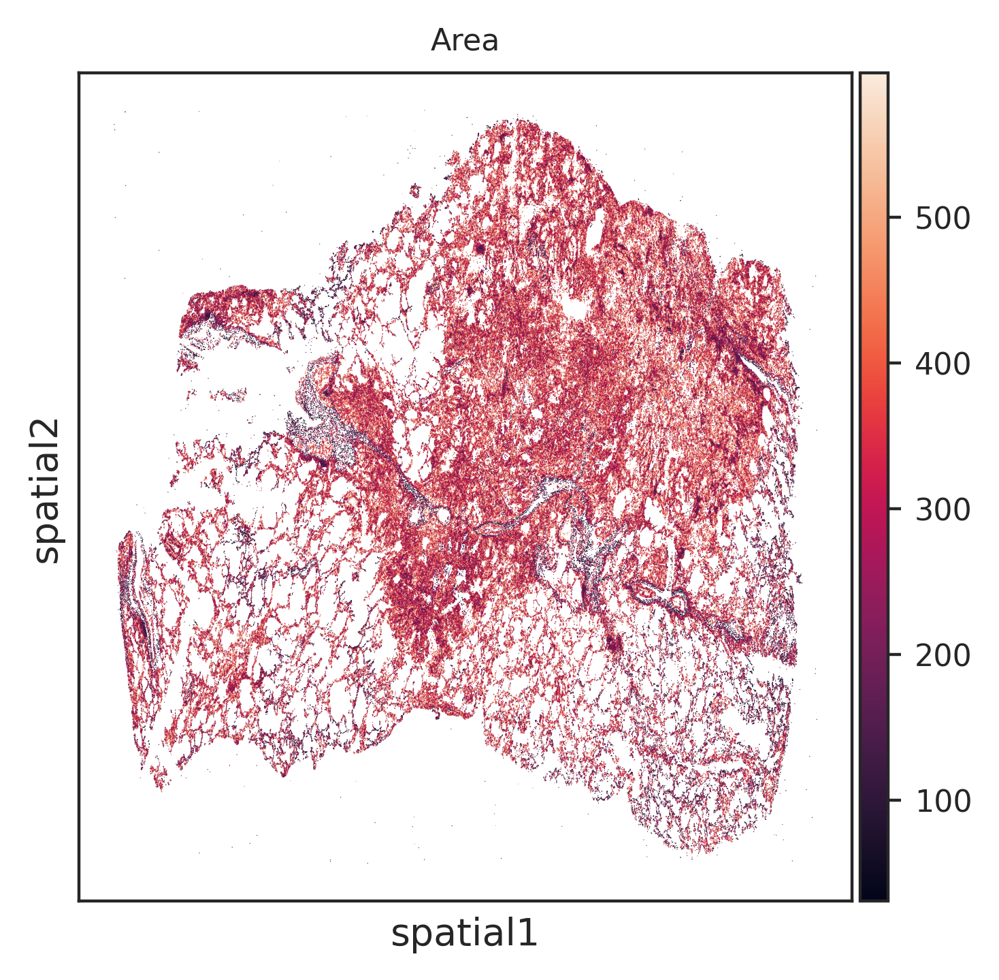

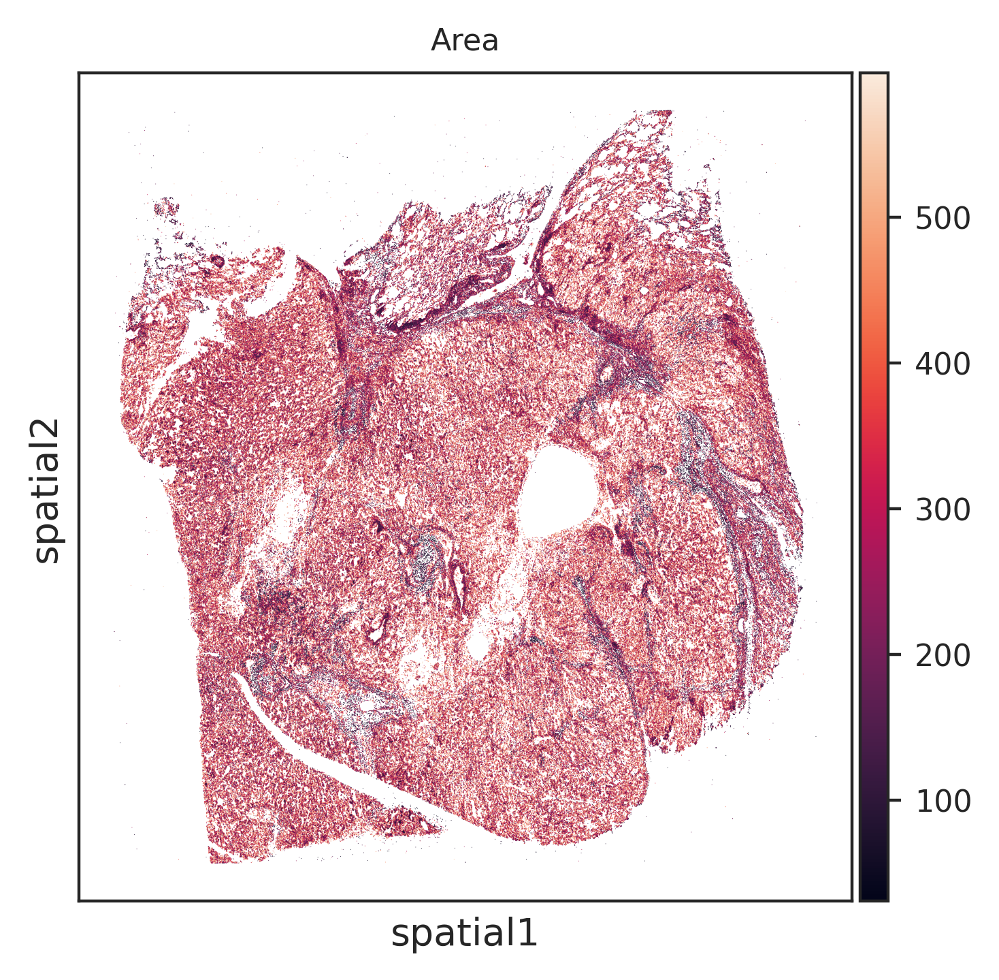

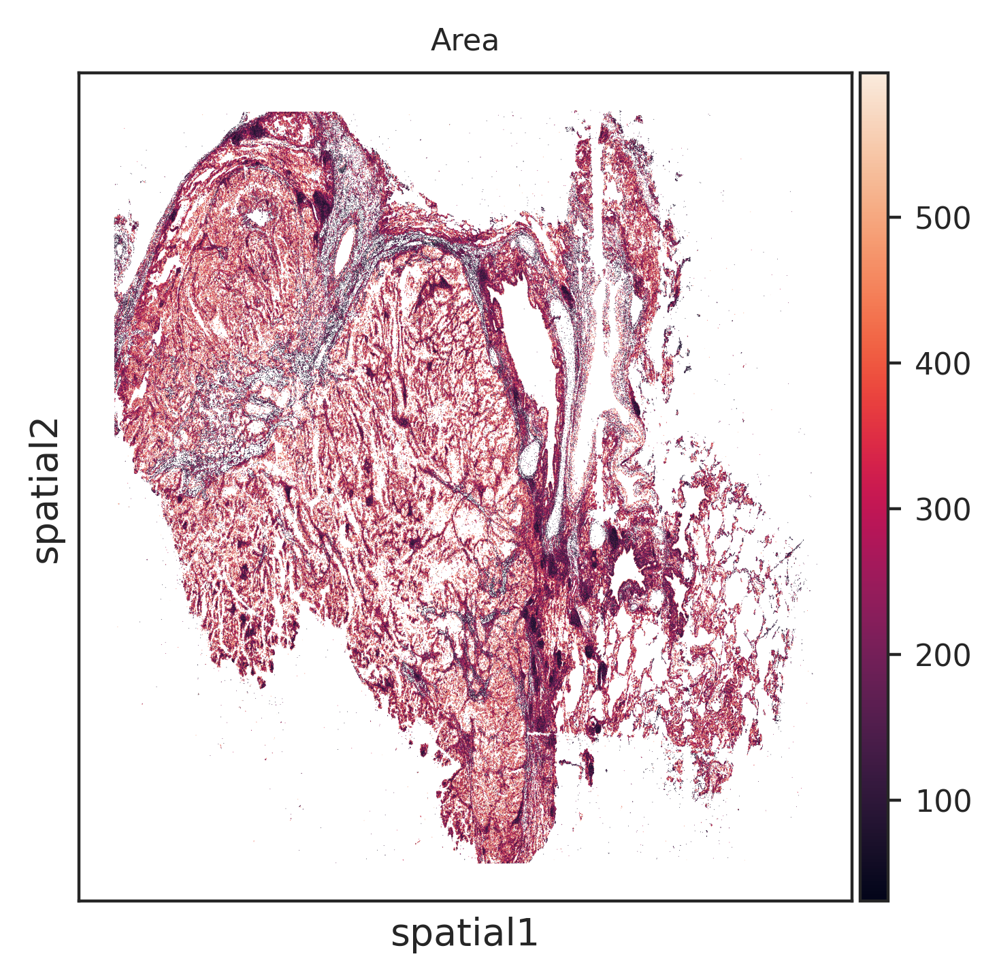

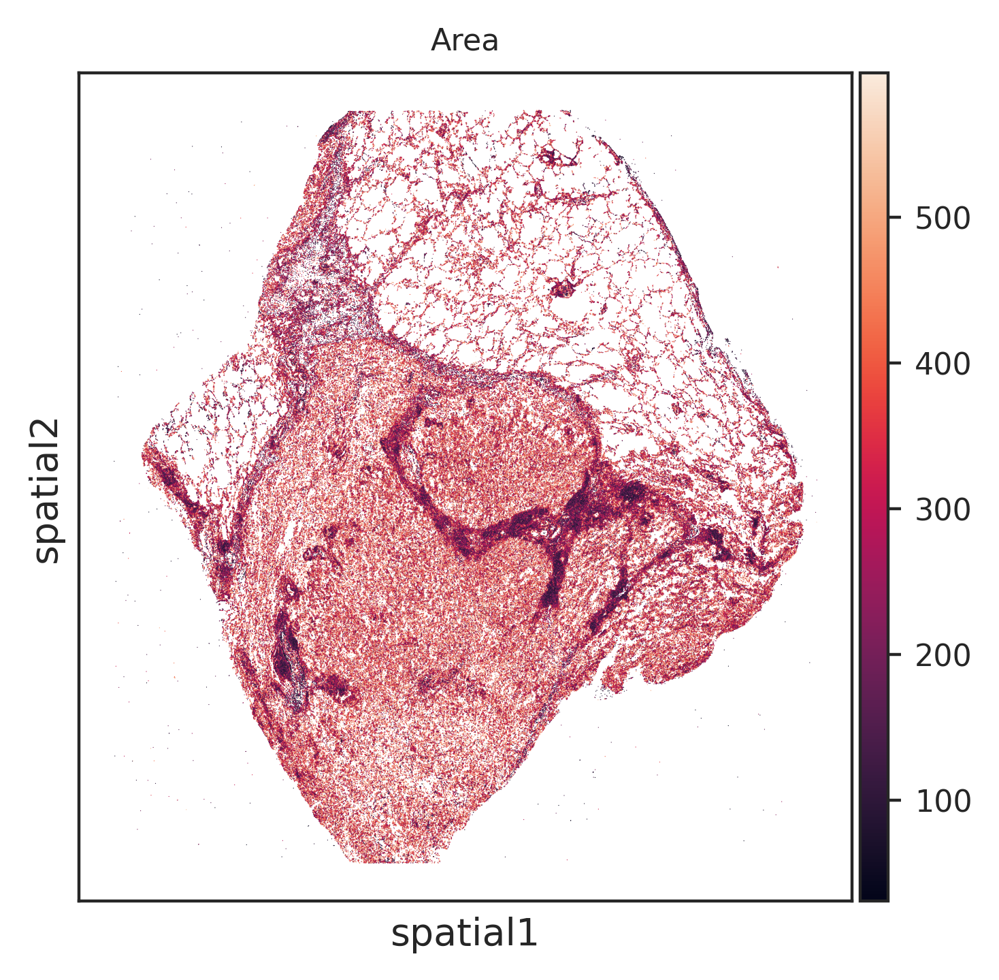

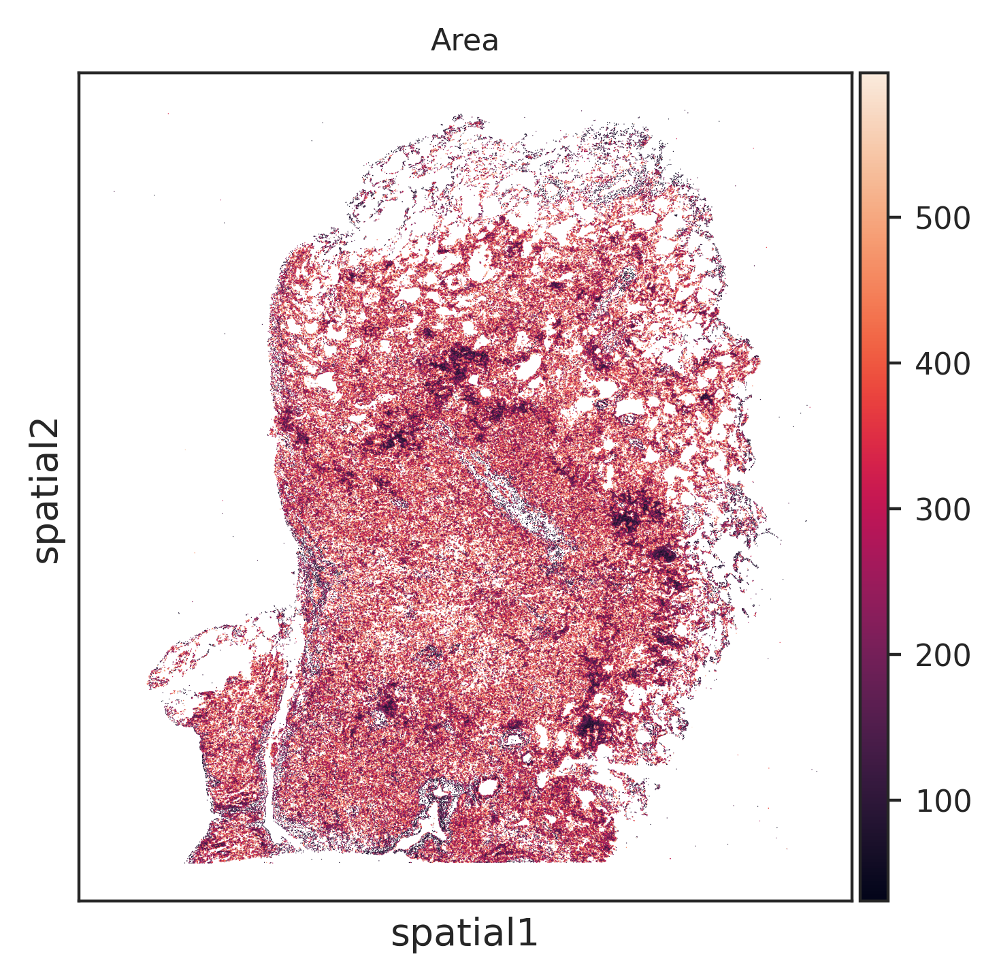

...

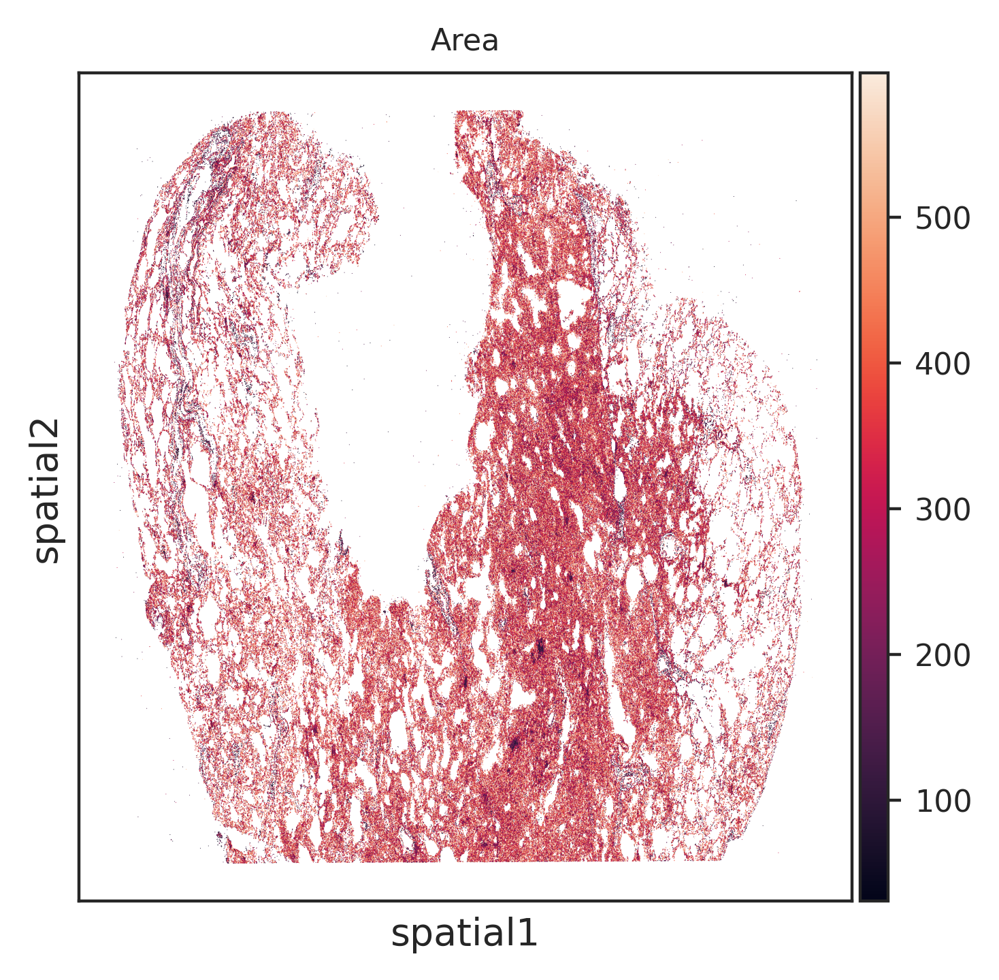

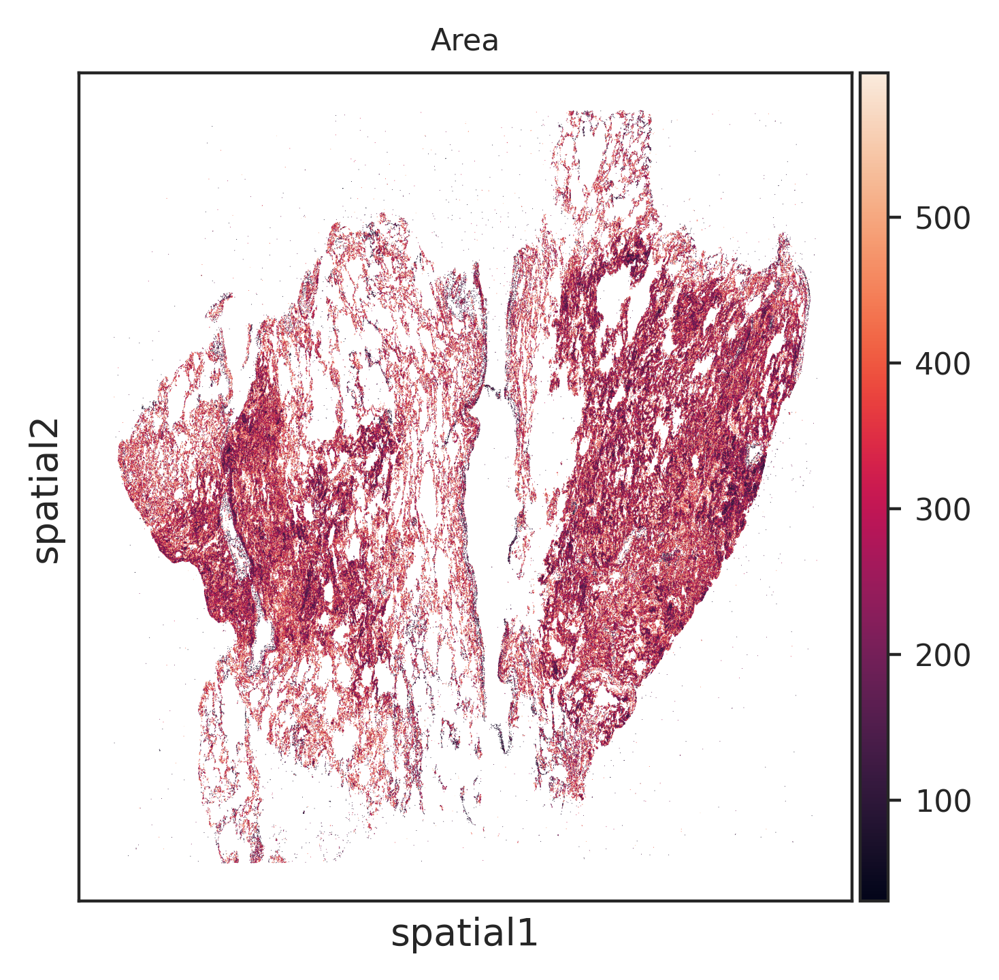

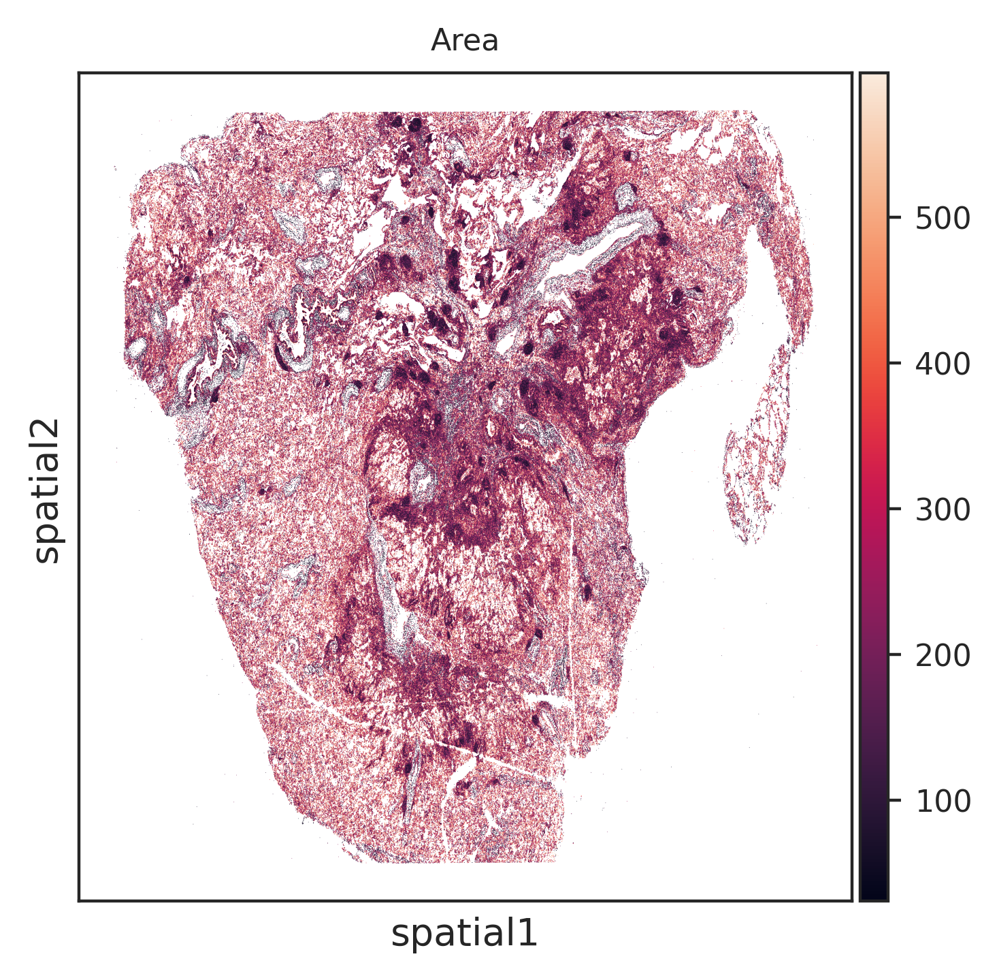

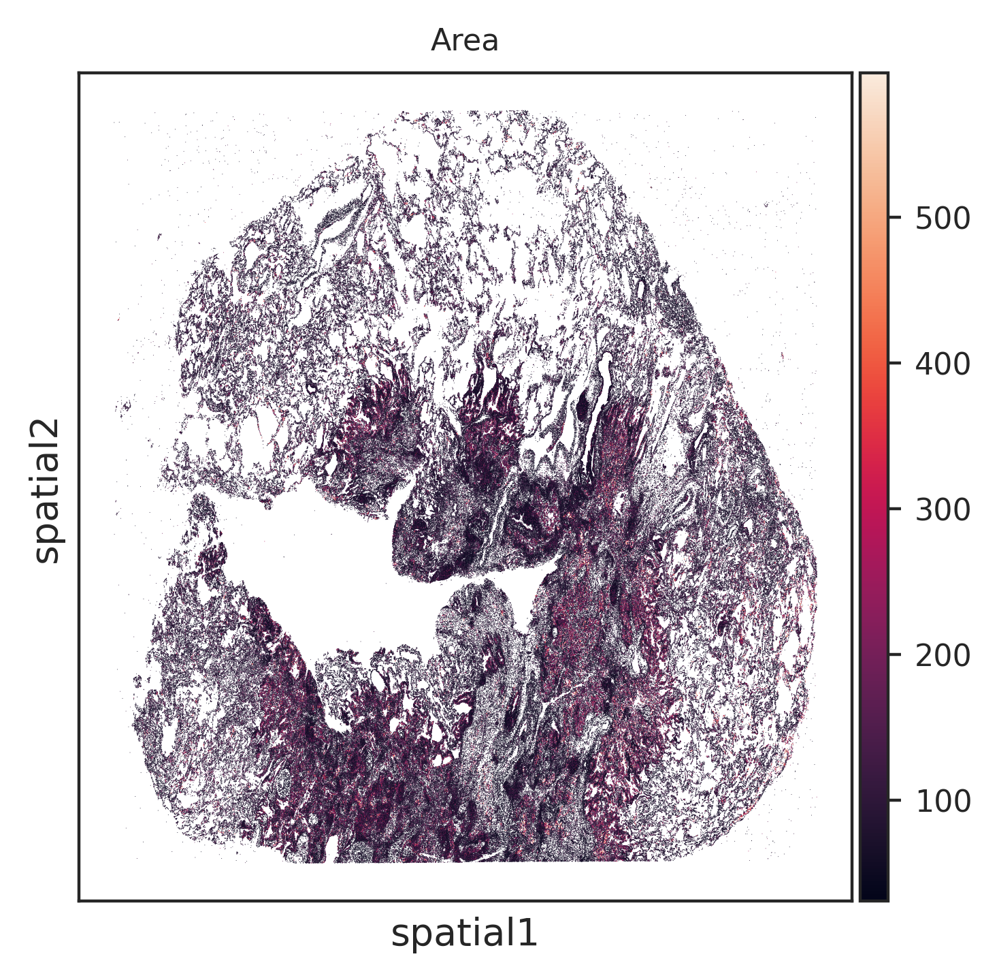

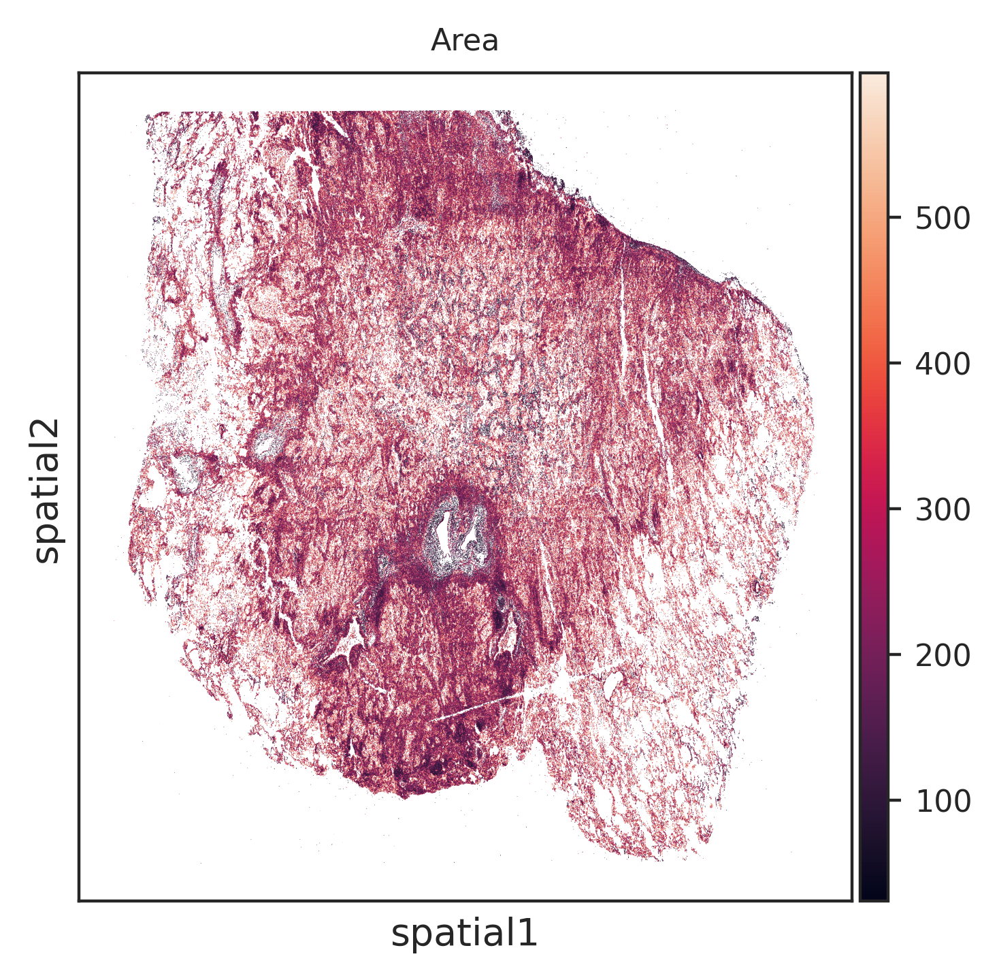

In [36]:
for pid in np.unique(adata.obs['PID']):
    adata_sub = adata[adata.obs['PID']==pid]
    adata_sub.write_h5ad(f'/home/yzy/PUBDT/st/tCyCIF/Wu2022spatial/h5ad/{pid}.h5ad')
    sc.pl.embedding(adata_sub,basis='spatial',color='Area')